# AquaGrade CNN Model

## Necessary Paths

In [ ]:
# * Paths
MODEL_PATH = './runs/detect/HOOKitModel-pre-v0.3/weights/HOOKit-pre-v0.3-best.pt'
IMAGE_FOLDER = '../dataset/test/images'
OUTPUT_FOLDER = './output_images'
ONNX_PATH = './runs/detect/HOOKitModel-pre-v0.3/weights/best.onnx'

## Pre-Training Phase

### Required Dependencies

In [1]:
# Install the requirements
%pip install -r requirements.txt


[notice] A new release of pip is available: 24.0 -> 24.2
[notice] To update, run: python.exe -m pip install --upgrade pip


### Imports

In [2]:
# * Import general libraries
import os
import yaml
import math
from pathlib import Path
import random

# * Import necessary libraries for image processing
import numpy as np
from PIL import Image

# * Imports for plotting
import matplotlib.pyplot as plt
import pandas as pd

# * Imports for GUI libraries
from tqdm import tqdm

# * Imports for documentations
from docx import Document
from docx.shared import Inches

# * Import necessary libraries for model training
import torch
import torchmetrics
import torchvision 
from torchvision import datasets, transforms 
from torch.utils.data import DataLoader
from torchvision.datasets import ImageFolder
from torch import nn, optim
import torchvision.transforms.functional as F


# * Import sci-kit cross-validation libraries
from sklearn.model_selection import KFold
from sklearn.metrics import confusion_matrix, precision_recall_fscore_support, precision_recall_curve, ConfusionMatrixDisplay

### Dataset Preparation

In [21]:
# Get the absolute path to the main project directory
project_dir = os.path.abspath(os.path.join(os.getcwd(), '..'))

# Load the dataset path
dataset_path = os.path.join(project_dir, 'dataset')

# Read the original data.yaml file
with open(os.path.join(dataset_path, 'data.yaml'), 'r') as file:
    data_yaml = yaml.safe_load(file)

# Update paths in data.yaml to correct relative paths
data_yaml['train'] = os.path.join('train', 'images')
data_yaml['val'] = os.path.join('valid', 'images')
data_yaml['test'] = os.path.join('test', 'images')

# Save the updated data.yaml
with open(os.path.join(dataset_path, 'data_updated.yaml'), 'w') as file:
    yaml.dump(data_yaml, file)

print("Updated YAML content:")
print(yaml.dump(data_yaml, default_flow_style=False))

# Verify paths
print("\nVerifying paths:")
print(f"Train path exists: {os.path.exists(
    os.path.join(dataset_path, data_yaml['train']))}")
print(f"Validation path exists: {os.path.exists(
    os.path.join(dataset_path, data_yaml['val']))}")
print(f"Test path exists: {os.path.exists(
    os.path.join(dataset_path, data_yaml['test']))}")

# Print full paths for reference
print("\nFull paths:")
print(f"Train: {os.path.abspath(
    os.path.join(dataset_path, data_yaml['train']))}")
print(f"Validation: {os.path.abspath(
    os.path.join(dataset_path, data_yaml['val']))}")
print(f"Test: {os.path.abspath(
    os.path.join(dataset_path, data_yaml['test']))}")

Updated YAML content:
names:
- Bangus-SKIN -0-
- Bangus-SKIN -1-
- Bangus-SKIN -2-
- Bangus-GILL-COVER -0-
- Bangus-GILL-COVER -1-
- Bangus-GILL-COVER -2-
- Bangus-GILL-COVER -3-
- Bangus-EYE-CLARITY -0-
- Bangus-EYE-CLARITY -1-
- Bangus-EYE-SHAPE -0-
- Bangus-EYE-SHAPE -1-
- Bangus-EYE-SHAPE -2-
- Tilapia-SKIN -0-
- Tilapia-SKIN -1-
- Tilapia-SKIN -2-
- Tilapia-GILL-COVER -0-
- Tilapia-GILL-COVER -1-
- Tilapia-GILL-COVER -2-
- Tilapia-GILL-COVER -3-
- Tilapia-EYE-CLARITY -0-
- Tilapia-EYE-CLARITY -1-
- Tilapia-EYE-SHAPE -0-
- Tilapia-EYE-SHAPE -1-
- Tilapia-EYE-SHAPE -2-
- Galunggong-SKIN -0-
- Galunggong-SKIN -1-
- Galunggong-SKIN -2-
- Galunggong-GILL-COVER -0-
- Galunggong-GILL-COVER -1-
- Galunggong-GILL-COVER -2-
- Galunggong-GILL-COVER -3-
- Galunggong-EYE-CLARITY -0-
- Galunggong-EYE-CLARITY -1-
- Galunggong-EYE-SHAPE -0-
- Galunggong-EYE-SHAPE -1-
- Galunggong-EYE-SHAPE -2-
nc: 36
test: test\images
train: train\images
val: valid\images


Verifying paths:
Train path exists: Tru

### Training and Validation Dataset Images

Loading images: 100%|██████████| 80/80 [00:02<00:00, 32.41it/s]


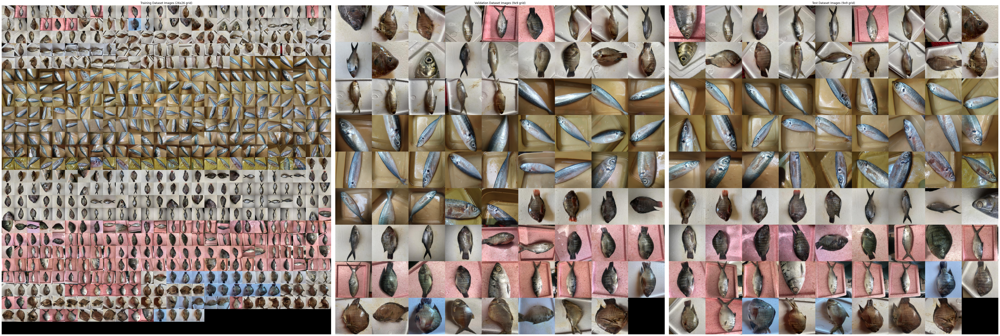

Total training images displayed: 640
Total training images in dataset: 640
Total validation images displayed: 80
Total validation images in dataset: 80
Total test images displayed: 80
Total test images in dataset: 80


In [22]:
# Function to load and resize images
def load_and_resize_image(image_path, target_size=(100, 100)):
    try:
        with Image.open(image_path) as img:
            return img.resize(target_size, Image.LANCZOS)
    except Exception as e:
        print(f"Error loading image {image_path}: {str(e)}")
        return Image.new('RGB', target_size, color='red')

# Function to create image grid
def create_image_grid(images_path, grid_size):
    image_files = [f for f in os.listdir(images_path) if f.lower().endswith(
        ('.png', '.jpg', '.jpeg', '.bmp', '.gif'))]
    grid = np.zeros((grid_size * 100, grid_size * 100, 3), dtype=np.uint8)
    for i, img_file in enumerate(tqdm(image_files[:grid_size*grid_size], desc="Loading images")):
        if i >= grid_size * grid_size:
            break
        row = i // grid_size
        col = i % grid_size
        img_path = os.path.join(images_path, img_file)
        img = load_and_resize_image(img_path)
        grid[row*100:(row+1)*100, col*100:(col+1)*100] = np.array(img)
    return grid, len(image_files)


# Path to your training, validation, and test images
train_images_path = os.path.join(dataset_path, data_yaml['train'])
val_images_path = os.path.join(dataset_path, data_yaml['val'])
test_images_path = os.path.join(dataset_path, data_yaml['test'])

# Calculate grid size for all sets
train_grid_size = min(100, math.ceil(
    math.sqrt(len(os.listdir(train_images_path)))))
val_grid_size = min(100, math.ceil(
    math.sqrt(len(os.listdir(val_images_path)))))
test_grid_size = min(100, math.ceil(
    math.sqrt(len(os.listdir(test_images_path)))))

# Create grids
train_grid, train_total = create_image_grid(train_images_path, train_grid_size)
val_grid, val_total = create_image_grid(val_images_path, val_grid_size)
test_grid, test_total = create_image_grid(test_images_path, test_grid_size)

# Display the grids
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(60, 20))

ax1.imshow(train_grid)
ax1.axis('off')
ax1.set_title(f"Training Dataset Images ({
              train_grid_size}x{train_grid_size} grid)")

ax2.imshow(val_grid)
ax2.axis('off')
ax2.set_title(f"Validation Dataset Images ({
              val_grid_size}x{val_grid_size} grid)")

ax3.imshow(test_grid)
ax3.axis('off')
ax3.set_title(f"Test Dataset Images ({test_grid_size}x{test_grid_size} grid)")

plt.tight_layout()
plt.show()

print(f"Total training images displayed: {
      min(train_grid_size*train_grid_size, train_total)}")
print(f"Total training images in dataset: {train_total}")
print(f"Total validation images displayed: {
      min(val_grid_size*val_grid_size, val_total)}")
print(f"Total validation images in dataset: {val_total}")
print(f"Total test images displayed: {
      min(test_grid_size*test_grid_size, test_total)}")
print(f"Total test images in dataset: {test_total}")

## Training Phase

### Model Training

In [ ]:
# Load YAML configuration
def load_data_from_yaml(yaml_path):
    with open(yaml_path, 'r') as file:
        data = yaml.safe_load(file)
    return data

# Residual Block Definition
class ResidualBlock(nn.Module):
    def __init__(self, in_channels, out_channels, stride=1):
        super(ResidualBlock, self).__init__()
        self.conv1 = nn.Conv2d(
            in_channels, out_channels, kernel_size=3, stride=stride, padding=1, bias=False)
        self.bn1 = nn.BatchNorm2d(out_channels)
        self.relu = nn.ReLU(inplace=True)
        self.conv2 = nn.Conv2d(out_channels, out_channels,
                               kernel_size=3, stride=1, padding=1, bias=False)
        self.bn2 = nn.BatchNorm2d(out_channels)
        self.shortcut = nn.Sequential()
        if stride != 1 or in_channels != out_channels:
            self.shortcut = nn.Sequential(
                nn.Conv2d(in_channels, out_channels, kernel_size=1,
                          stride=stride, bias=False),
                nn.BatchNorm2d(out_channels)
            )

    def forward(self, x):
        out = self.relu(self.bn1(self.conv1(x)))
        out = self.bn2(self.conv2(out))
        out += self.shortcut(x)
        out = self.relu(out)
        return out

# Fish Freshness Model Definition
class FishFreshnessModel(nn.Module):
    def __init__(self, num_classes=4):
        super(FishFreshnessModel, self).__init__()
        self.in_channels = 64
        self.conv1 = nn.Conv2d(3, 64, kernel_size=7,
                               stride=2, padding=3, bias=False)
        self.bn1 = nn.BatchNorm2d(64)
        self.relu = nn.ReLU(inplace=True)
        self.maxpool = nn.MaxPool2d(kernel_size=3, stride=2, padding=1)
        self.layer1 = self._make_layer(64, 2)
        self.layer2 = self._make_layer(128, 2, stride=2)
        self.layer3 = self._make_layer(256, 2, stride=2)
        self.layer4 = self._make_layer(512, 2, stride=2)
        self.avgpool = nn.AdaptiveAvgPool2d((1, 1))
        self.fc_layers = nn.ModuleList([
            nn.Sequential(
                nn.Linear(512, 256),
                nn.ReLU(),
                nn.Dropout(0.5),
                nn.Linear(256, 128),
                nn.ReLU(),
                nn.Dropout(0.3),
                nn.Linear(128, 1)
            ) for _ in range(num_classes)
        ])

    def _make_layer(self, out_channels, blocks, stride=1):
        layers = []
        layers.append(ResidualBlock(self.in_channels, out_channels, stride))
        self.in_channels = out_channels
        for _ in range(1, blocks):
            layers.append(ResidualBlock(out_channels, out_channels))
        return nn.Sequential(*layers)

    def forward(self, x):
        x = self.conv1(x)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.maxpool(x)
        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)
        x = self.avgpool(x)
        x = torch.flatten(x, 1)
        outputs = [fc(x) for fc in self.fc_layers]
        return outputs

# Focal Loss Definition
class FocalLoss(nn.Module):
    def __init__(self, alpha=1, gamma=2, reduction='mean'):
        super(FocalLoss, self).__init__()
        self.alpha = alpha
        self.gamma = gamma
        self.reduction = reduction

    def forward(self, inputs, targets):
        mse_loss = torch.nn.functional.mse_loss(
            inputs, targets, reduction='none')
        pt = torch.exp(-mse_loss)
        focal_loss = self.alpha * (1-pt)**self.gamma * mse_loss
        if self.reduction == 'mean':
            return torch.mean(focal_loss)
        elif self.reduction == 'sum':
            return torch.sum(focal_loss)
        else:
            return focal_loss

# Early Stopping Class
class EarlyStopping:
    def __init__(self, patience=7, verbose=False, delta=0, path='models/best_model.pt'):
        self.patience = patience
        self.verbose = verbose
        self.delta = delta
        self.path = path
        self.best_score = None
        self.early_stop = False
        self.val_loss_min = float('inf')
        self.counter = 0

    def __call__(self, val_loss, model):
        score = -val_loss
        if self.best_score is None:
            self.best_score = score
            self.save_checkpoint(val_loss, model)
        elif score < self.best_score + self.delta:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.save_checkpoint(val_loss, model)
            self.counter = 0

    def save_checkpoint(self, val_loss, model):
        if self.verbose:
            print(f'Validation loss decreased ({
                  self.val_loss_min:.6f} --> {val_loss:.6f}). Saving model ...')
        os.makedirs(os.path.dirname(self.path), exist_ok=True)
        torch.save(model.state_dict(), self.path)
        self.val_loss_min = val_loss

# Custom transformation to randomly apply color jitter
class RandomColorJitter(transforms.ColorJitter):
    def __init__(self, brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1):
        super().__init__(brightness=brightness, contrast=contrast, saturation=saturation, hue=hue)
        self.probability = 0.5

    def __call__(self, img):
        if random.random() < self.probability:
            img = super().__call__(img)
        return img
    
# Function to save metrics and plots
def save_metrics_and_plots(cm, precision, recall, f1, version, output_dir='outputs'):
    version_dir = os.path.join(output_dir, version)
    os.makedirs(version_dir, exist_ok=True)

    # Save confusion matrix
    disp = ConfusionMatrixDisplay(confusion_matrix=cm)
    disp.plot(cmap=plt.cm.Blues)
    plt.savefig(os.path.join(version_dir, 'confusion_matrix.png'))
    plt.close()

    # Precision-Recall Curve
    precision_vals, recall_vals, _ = precision_recall_curve(
        np.array(all_labels), np.array(all_preds))
    plt.plot(recall_vals, precision_vals, marker='.')
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.savefig(os.path.join(version_dir, 'precision_recall_curve.png'))
    plt.close()

# Function to generate the model summary report in a .docx file
def generate_summary_report(version, val_loss, cm, precision, recall, f1, output_dir='outputs'):
    doc = Document()
    version_dir = os.path.join(output_dir, version)
    doc.add_heading(f'Model Summary Report: {version}', 0)
    doc.add_heading('Basic Model Information', level=1)
    doc.add_paragraph(f'Validation Loss: {val_loss:.4f}')
    doc.add_paragraph(f'Precision: {precision:.4f}')
    doc.add_paragraph(f'Recall: {recall:.4f}')
    doc.add_paragraph(f'F1-Score: {f1:.4f}')
    doc.add_heading('Confusion Matrix', level=1)
    cm_path = os.path.join(version_dir, 'confusion_matrix.png')
    doc.add_paragraph(
        'The confusion matrix provides insight into the classification performance:')
    doc.add_picture(cm_path, width=Inches(5.0))
    doc.add_paragraph(
        'Interpretation: Analyze the False Positives (FP), False Negatives (FN), and correct classifications (True Positives and True Negatives).')
    doc.add_heading('Precision-Recall Curve', level=1)
    pr_curve_path = os.path.join(version_dir, 'precision_recall_curve.png')
    doc.add_paragraph(
        'The Precision-Recall curve shows the trade-off between precision and recall for different thresholds:')
    doc.add_picture(pr_curve_path, width=Inches(5.0))
    doc.add_paragraph(
        'Interpretation: Evaluate how well the model balances precision and recall, and determine the optimal threshold for deployment.')
    doc.add_heading('Suggestions for Fine-Tuning or Retraining', level=1)
    doc.add_paragraph(
        'Based on the performance metrics and graph interpretations, consider the following:')
    doc.add_paragraph(
        '1. If precision is low: Investigate the sources of False Positives and consider adjusting the decision threshold or fine-tuning the model.')
    doc.add_paragraph(
        '2. If recall is low: Explore the reasons for False Negatives, which might suggest underfitting or the need for more data augmentation.')
    doc.add_paragraph(
        '3. If the model is overfitting: Consider early stopping, regularization techniques, or more data.')
    report_path = os.path.join(version_dir, 'model_summary_report.docx')
    doc.save(report_path)

# Function to validate the model
def validate_model(model, val_loader, criterion, device, version, output_dir='outputs'):
    model.eval()
    val_loss = 0.0
    all_preds = []
    all_labels = []
    with torch.no_grad():
        for inputs, labels in val_loader:
            inputs = inputs.to(device)
            labels = [label.to(device) for label in labels]

            outputs = model(inputs)
            loss = sum(criterion(output, label)
                       for output, label in zip(outputs, labels))
            val_loss += loss.item() * inputs.size(0)

            for output, label in zip(outputs, labels):
                preds = torch.sigmoid(output).round().cpu().numpy()
                all_preds.extend(preds)
                all_labels.extend(label.cpu().numpy())

    val_loss /= len(val_loader.dataset)
    cm = confusion_matrix(all_labels, all_preds)
    precision, recall, f1, _ = precision_recall_fscore_support(
        all_labels, all_preds, average='binary')

    # Save metrics and plots
    save_metrics_and_plots(cm, precision, recall, f1, version, output_dir)

    # Generate and save model summary report
    generate_summary_report(version, val_loss, cm,
                            precision, recall, f1, output_dir)

    return val_loss, cm, precision, recall, f1

# Training Loop
def train_model(model, train_loader, val_loader, criterion, optimizer, num_epochs, device, version, output_dir='outputs'):
    early_stopping = EarlyStopping(
        patience=7, verbose=True, path=os.path.join('models', f'{version}.pt'))
    for epoch in range(num_epochs):
        model.train()
        running_loss = 0.0
        for inputs, labels in train_loader:
            inputs = inputs.to(device)
            labels = [label.to(device) for label in labels]

            optimizer.zero_grad()
            outputs = model(inputs)
            loss = sum(criterion(output, label)
                       for output, label in zip(outputs, labels))
            loss.backward()
            optimizer.step()
            running_loss += loss.item() * inputs.size(0)

        epoch_loss = running_loss / len(train_loader.dataset)
        print(f'Epoch {epoch+1}/{num_epochs}, Loss: {epoch_loss:.4f}')

        # Validate and check for early stopping
        val_loss, cm, precision, recall, f1 = validate_model(
            model, val_loader, criterion, device, version, output_dir)
        early_stopping(val_loss, model)

        if early_stopping.early_stop:
            print("Early stopping")
            break

# Cross-Validation Function
def cross_validate(dataset, model_class, num_folds=5, num_epochs=25, batch_size=32, learning_rate=0.001, output_dir='outputs'):
    kfold = KFold(n_splits=num_folds, shuffle=True)
    device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

    for fold, (train_idx, val_idx) in enumerate(kfold.split(dataset)):
        print(f'Fold {fold+1}/{num_folds}')
        train_subsampler = torch.utils.data.SubsetRandomSampler(train_idx)
        val_subsampler = torch.utils.data.SubsetRandomSampler(val_idx)

        train_loader = DataLoader(
            dataset, batch_size=batch_size, sampler=train_subsampler)
        val_loader = DataLoader(
            dataset, batch_size=batch_size, sampler=val_subsampler)

        model = model_class().to(device)
        criterion = FocalLoss()
        optimizer = optim.Adam(model.parameters(), lr=learning_rate)

        version = f'AquaGrade-v1.{fold+1}'
        train_model(model, train_loader, val_loader, criterion,
                    optimizer, num_epochs, device, version, output_dir)


# * Main execution
if __name__ == "__main__":
    yaml_path = '..\dataset\data_updated.yaml'
    data_config = load_data_from_yaml(yaml_path)

    # * Online data augmentation pipeline setup
    train_transform = transforms.Compose([
        # ? Randomly resizes and crops image to 224x224 (suitable for ResNet)
        transforms.RandomResizedCrop(size=224, scale=(0.8, 1.0)),
        
        # ? Random horizontal flip to add variability in orientation
        transforms.RandomHorizontalFlip(p=0.5),
        
        # ? Random vertical flips, set with a lower probability (if applicable for this domain)
        transforms.RandomVerticalFlip(p=0.2),
        
        # ? Random rotation to handle small rotations during image capture
        transforms.RandomRotation(degrees=15),
        
        # ? Random color jitter to simulate varying lighting conditions
        RandomColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1),
        
        # ? Adds Gaussian blur to simulate out-of-focus effects
        transforms.GaussianBlur(kernel_size=(5, 9), sigma=(0.1, 5)),
        
        # ? Adding slight noise to simulate camera or environmental noise
        transforms.Lambda(lambda img: F.adjust_gamma(img, gamma=random.uniform(0.8, 1.2))),
        
        # ? Randomly erases patches to force the model to learn more robust features
        transforms.RandomErasing(p=0.5, scale=(0.02, 0.1), ratio=(0.3, 3.3), value='random'),
        
        # ? Converts image to tensor and normalize it based on ImageNet statistics (common practice)
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])

    train_dataset = datasets.ImageFolder(
        root=data_config['train'], transform=train_transform)

    print(f"Number of classes: {len(train_dataset.classes)}")
    print(f"Class names: {train_dataset.classes}")

    os.makedirs('models', exist_ok=True)
    os.makedirs('outputs', exist_ok=True)

    cross_validate(train_dataset, FishFreshnessModel, num_folds=5,
                   num_epochs=25, batch_size=32, learning_rate=0.001, output_dir='outputs')

## Load Trained Model's Architecture

In [ ]:
state_dict = torch.load('./runs/detect/HOOKitModel-pre-v0.3/weights/best.pt')

for key, value in state_dict.items():
    if isinstance(value, torch.Tensor):
        print(f"{key}: Tensor with shape {value.shape}")
    else:
        print(f"{key}: {type(value)} with value {value}")

## Testing Phase

_this section tests the TRAINED MODEL against UNSEEN DATA both static and realtime_ 

### Insert an Image Approach Inference OR Folder of Images

In [ ]:
import tkinter as tk
from tkinter import filedialog, messagebox, ttk
from ultralytics import YOLO
from PIL import Image, ImageTk
import numpy as np
import cv2
import os
import math
import sys


def create_image_grid(image_folder, grid_size=(5, 5)):
    """Create a grid of images from the output folder."""
    images = [img for img in os.listdir(
        image_folder) if img.startswith("output_")]
    if not images:
        print("No output images found.")
        return None

    n = min(len(images), grid_size[0] * grid_size[1])
    rows = min(grid_size[0], math.ceil(math.sqrt(n)))
    cols = min(grid_size[1], math.ceil(n / rows))

    with Image.open(os.path.join(image_folder, images[0])) as img:
        w, h = img.size

    grid_img = Image.new('RGB', (cols * w, rows * h), color='white')

    for i, image in enumerate(images[:n]):
        with Image.open(os.path.join(image_folder, image)) as img:
            grid_img.paste(img, ((i % cols) * w, (i // cols) * h))

    return grid_img


def load_model(model_path):
    """Load the YOLOv8 model."""
    try:
        return YOLO(model_path)
    except Exception as e:
        print(f"Error loading model: {e}")
        sys.exit(1)


def perform_inference(model, image_path):
    """Perform inference on the given image."""
    try:
        results = model(image_path)
        return results[0]
    except Exception as e:
        print(f"Error during inference: {e}")
        return None


def visualize_results(image_path, results):
    """Visualize the results on the image."""
    try:
        img = cv2.imread(image_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        result_plot = results.plot()
        return Image.fromarray(result_plot)
    except Exception as e:
        print(f"Error visualizing results: {e}")
        return None


def process_detections(results):
    """Process and return detection data."""
    detections = []
    for box in results.boxes:
        detections.append({
            'box': box.xyxy[0].tolist(),
            'confidence': float(box.conf[0]),
            'class': int(box.cls[0])
        })
    return detections


def safe_save(image, output_path):
    """Save the image with a unique filename to avoid overwriting."""
    base, ext = os.path.splitext(output_path)
    counter = 1
    while os.path.exists(output_path):
        output_path = f"{base}_{counter}{ext}"
        counter += 1
    image.save(output_path)
    return output_path


def process_image(model, image_path, output_folder):
    """Process a single image."""
    results = perform_inference(model, image_path)
    if results is None:
        return

    result_image = visualize_results(image_path, results)
    if result_image is None:
        return

    filename = os.path.basename(image_path)
    output_path = os.path.join(output_folder, f"output_{filename}")
    saved_path = safe_save(result_image, output_path)
    print(f"Result image saved as '{saved_path}'")

    detections = process_detections(results)
    print(f"Detections for {filename}:")
    for detection in detections:
        print(f"Box: {detection['box']}")
        print(f"Confidence: {detection['confidence']}")
        print(f"Class: {detection['class']}")
        print("---")
    print("\n")


def process_folder(model, folder_path, output_folder):
    """Process all images in the specified folder."""
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    for filename in os.listdir(folder_path):
        if filename.lower().endswith(('.png', '.jpg', '.jpeg', '.tiff', '.bmp', '.gif')):
            image_path = os.path.join(folder_path, filename)
            process_image(model, image_path, output_folder)


def get_next_grid_number():
    i = 1
    while os.path.exists(f"image_grid_output_{i}.jpg"):
        i += 1
    return i


class YOLOApp:
    def __init__(self, master):
        self.master = master
        master.title("HOOKit pre-release v0.3")
        master.geometry("500x700")

        self.model = None
        self.current_image = None
        self.output_folder = None

        # Create main frame
        main_frame = ttk.Frame(master, padding="10")
        main_frame.grid(row=0, column=0, sticky=(tk.W, tk.E, tk.N, tk.S))
        master.columnconfigure(0, weight=1)
        master.rowconfigure(0, weight=1)

        # Model container
        model_frame = ttk.LabelFrame(
            main_frame, text="Model Selection", padding="10")
        model_frame.grid(row=0, column=0, columnspan=2,
                         sticky=(tk.W, tk.E), pady=5)
        model_frame.columnconfigure(1, weight=1)

        self.model_button = ttk.Button(
            model_frame, text="Load Model", command=self.load_model)
        self.model_button.grid(row=0, column=0, sticky=tk.W)

        self.current_model_label = ttk.Label(
            model_frame, text="Current Model: None")
        self.current_model_label.grid(
            row=0, column=1, sticky=tk.W, padx=(10, 0))

        # Image selection container
        image_frame = ttk.LabelFrame(
            main_frame, text="Image Selection", padding="10")
        image_frame.grid(row=1, column=0, sticky=(tk.W, tk.E), pady=5)
        image_frame.columnconfigure(1, weight=1)

        self.image_button = ttk.Button(
            image_frame, text="Choose Image", command=self.load_image)
        self.image_button.grid(row=0, column=0, sticky=tk.W)

        self.current_image_label = ttk.Label(
            image_frame, text="No image selected")
        self.current_image_label.grid(
            row=0, column=1, sticky=tk.W, padx=(10, 0))

        # Output folder container
        output_frame = ttk.LabelFrame(
            main_frame, text="Output Folder", padding="10")
        output_frame.grid(row=1, column=1, sticky=(tk.W, tk.E), pady=5)
        output_frame.columnconfigure(1, weight=1)

        self.output_button = ttk.Button(
            output_frame, text="Set Output Folder", command=self.set_output_folder)
        self.output_button.grid(row=0, column=0, sticky=tk.W)

        self.output_label = ttk.Label(output_frame, text="No folder selected")
        self.output_label.grid(row=0, column=1, sticky=tk.W, padx=(10, 0))

        # Infer container
        infer_frame = ttk.LabelFrame(
            main_frame, text="Inference", padding="10")
        infer_frame.grid(row=2, column=0, columnspan=2,
                         sticky=(tk.W, tk.E), pady=5)

        self.infer_button = ttk.Button(
            infer_frame, text="Infer Now", command=self.infer_now, state=tk.DISABLED)
        self.infer_button.pack()

        # Folder processing container
        folder_frame = ttk.LabelFrame(
            main_frame, text="Multiple Image Processing", padding="10")
        folder_frame.grid(row=3, column=0, columnspan=2,
                          sticky=(tk.W, tk.E), pady=5)

        self.folder_button = ttk.Button(
            folder_frame, text="Select a Folder", command=self.process_folder)
        self.folder_button.pack()

        # Real-time inference container
        realtime_frame = ttk.LabelFrame(
            main_frame, text="Real-time Inference", padding="10")
        realtime_frame.grid(row=4, column=0, columnspan=2,
                            sticky=(tk.W, tk.E), pady=5)

        self.realtime_button = ttk.Button(
            realtime_frame, text="Start Real-time Inference", command=self.toggle_realtime_inference)
        self.realtime_button.pack()

        self.camera_var = tk.StringVar()
        self.camera_dropdown = ttk.Combobox(
            realtime_frame, textvariable=self.camera_var)
        self.camera_dropdown.pack(pady=5)
        self.update_camera_list()

        # Add a label to display the webcam feed
        self.video_label = ttk.Label(main_frame)
        self.video_label.grid(row=5, column=0, columnspan=2, pady=5)

        # Initialize webcam variables
        self.cap = None
        self.is_realtime_active = False

    def load_model(self):
        model_path = filedialog.askopenfilename(
            filetypes=[("YOLO Model", "*.pt")])
        if model_path:
            try:
                self.model = load_model(model_path)
                model_name = os.path.basename(model_path)
                self.current_model_label.config(
                    text=f"Current Model: {model_name}")
                messagebox.showinfo("Success", "Model loaded successfully!")
            except Exception as e:
                messagebox.showerror(
                    "Error", f"Failed to load model: {str(e)}")

    def load_image(self):
        image_path = filedialog.askopenfilename(
            filetypes=[("Image files", "*.png *.jpg *.jpeg *.tiff *.bmp *.gif")])
        if image_path:
            self.current_image = image_path
            self.current_image_label.config(text=os.path.basename(image_path))
            self.infer_button.config(state=tk.NORMAL)
            messagebox.showinfo("Success", "Image loaded successfully!")

    def set_output_folder(self):
        self.output_folder = filedialog.askdirectory()
        if self.output_folder:
            self.output_label.config(text=os.path.basename(self.output_folder))
            messagebox.showinfo("Success", "Output folder set successfully!")

    def infer_now(self):
        if not self.model:
            messagebox.showerror("Error", "Please load a model first.")
            return
        if not self.output_folder:
            messagebox.showerror(
                "Error", "Please select an output folder first.")
            return
        if not self.current_image:
            messagebox.showerror("Error", "Please load an image first.")
            return

        process_image(self.model, self.current_image, self.output_folder)
        messagebox.showinfo("Success", "Image processed successfully!")

    def process_folder(self):
        if not self.model:
            messagebox.showerror("Error", "Please load a model first.")
            return
        if not self.output_folder:
            messagebox.showerror(
                "Error", "Please select an output folder first.")
            return

        folder_path = filedialog.askdirectory()
        if folder_path:
            process_folder(self.model, folder_path, self.output_folder)
            grid_image = create_image_grid(
                self.output_folder, grid_size=(5, 5))
            if grid_image:
                grid_number = get_next_grid_number()
                grid_filename = f"image_grid_output_{grid_number}.jpg"
                grid_image.save(os.path.join(
                    self.output_folder, grid_filename))
                messagebox.showinfo(
                    "Success", f"Folder processed and grid image saved as '{grid_filename}'")
            else:
                messagebox.showinfo(
                    "Success", "Folder processed successfully!")

    def list_available_cameras(self):
        index = 0
        cameras = []
        while True:
            cap = cv2.VideoCapture(index)
            if not cap.read()[0]:
                break
            else:
                cameras.append(index)
            cap.release()
            index += 1
        return cameras

    def update_camera_list(self):
        cameras = self.list_available_cameras()
        self.camera_dropdown['values'] = [f"Camera {i}" for i in cameras]
        if cameras:
            self.camera_dropdown.set(f"Camera {cameras[0]}")

    def toggle_realtime_inference(self):
        if not self.model:
            messagebox.showerror("Error", "Please load a model first.")
            return

        if self.is_realtime_active:
            self.stop_realtime_inference()
        else:
            self.start_realtime_inference()

    def start_realtime_inference(self):
        camera_index = int(self.camera_var.get().split()[-1])
        self.cap = cv2.VideoCapture(camera_index)
        if not self.cap.isOpened():
            messagebox.showerror(
                "Error", f"Failed to open camera {camera_index}")
            return
        self.is_realtime_active = True
        self.realtime_button.config(text="Stop Real-time Inference")
        self.update_webcam()

    def stop_realtime_inference(self):
        if self.cap:
            self.cap.release()
        self.is_realtime_active = False
        self.realtime_button.config(text="Start Real-time Inference")
        self.video_label.config(image='')

    def update_webcam(self):
        if self.is_realtime_active:
            ret, frame = self.cap.read()
            if ret:
                results = self.model(frame)
                result_frame = results[0].plot()
                img = Image.fromarray(cv2.cvtColor(
                    result_frame, cv2.COLOR_BGR2RGB))
                img = ImageTk.PhotoImage(img)
                self.video_label.config(image=img)
                self.video_label.image = img
            self.master.after(10, self.update_webcam)

    def on_closing(self):
        if self.cap:
            self.cap.release()
        self.master.destroy()


def main():
    root = tk.Tk()
    app = YOLOApp(root)
    root.protocol("WM_DELETE_WINDOW", app.on_closing)
    root.mainloop()


if __name__ == "__main__":
    main()

In [1]:
from PIL import Image, ImageTk

### Inference via Realtime Camera

In [ ]:
%pip install ultralytics opencv-python

from ultralytics import YOLO
import cv2

# Load the newly custom trained model
model = YOLO(MODEL_PATH)

# Open the laptop camera
cap = cv2.VideoCapture(1)

while True:
    # Read a frame from the camera
    ret, frame = cap.read()
    
    if not ret:
        break
    
    # Run inference on the frame
    results = model(frame)
    
    # Visualize the results on the frame
    annotated_frame = results[0].plot()
    
    # Display the annotated frame
    cv2.imshow("HOOKitModel-pre-v0.3", annotated_frame)
    
    # Break the loop if 'q' is pressed
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# Release the camera and close windows
cap.release()
cv2.destroyAllWindows()

## Pre-Deployment Phase

### Export the Base Model Summary into a .DOCX File

In [ ]:
# Parse the data
data = []
for line in """from n params module arguments
0 -1 1 464 ultralytics.nn.modules.conv.Conv [3, 16, 3, 2]
1 -1 1 4672 ultralytics.nn.modules.conv.Conv [16, 32, 3, 2]
2 -1 1 7360 ultralytics.nn.modules.block.C2f [32, 32, 1, True]
3 -1 1 18560 ultralytics.nn.modules.conv.Conv [32, 64, 3, 2]
4 -1 2 49664 ultralytics.nn.modules.block.C2f [64, 64, 2, True]
5 -1 1 73984 ultralytics.nn.modules.conv.Conv [64, 128, 3, 2]
6 -1 2 197632 ultralytics.nn.modules.block.C2f [128, 128, 2, True]
7 -1 1 295424 ultralytics.nn.modules.conv.Conv [128, 256, 3, 2]
8 -1 1 460288 ultralytics.nn.modules.block.C2f [256, 256, 1, True]
9 -1 1 164608 ultralytics.nn.modules.block.SPPF [256, 256, 5]
10 -1 1 0 torch.nn.modules.upsampling.Upsample [None, 2, 'nearest']
11 [-1, 6] 1 0 ultralytics.nn.modules.conv.Concat [1]
12 -1 1 148224 ultralytics.nn.modules.block.C2f [384, 128, 1]
13 -1 1 0 torch.nn.modules.upsampling.Upsample [None, 2, 'nearest']
14 [-1, 4] 1 0 ultralytics.nn.modules.conv.Concat [1]
15 -1 1 37248 ultralytics.nn.modules.block.C2f [192, 64, 1]
16 -1 1 36992 ultralytics.nn.modules.conv.Conv [64, 64, 3, 2]
17 [-1, 12] 1 0 ultralytics.nn.modules.conv.Concat [1]
18 -1 1 123648 ultralytics.nn.modules.block.C2f [192, 128, 1]
19 -1 1 147712 ultralytics.nn.modules.conv.Conv [128, 128, 3, 2]""".split('\n')[1:]:  # Skip the header
    parts = line.split()
    data.append({
        'n': parts[0],
        'from': parts[1],
        'params': parts[3],
        'module': parts[4],
        'arguments': ' '.join(parts[5:])
    })

# Create a pandas DataFrame
df = pd.DataFrame(data)

# Create a new Word document
doc = Document()

# Add a title
doc.add_heading('Model Summary', 0)

# Add the table
table = doc.add_table(rows=1, cols=5)
table.style = 'Table Grid'

# Add the header row
header_cells = table.rows[0].cells
header_cells[0].text = 'n'
header_cells[1].text = 'from'
header_cells[2].text = 'params'
header_cells[3].text = 'module'
header_cells[4].text = 'arguments'

# Add the data rows
for _, row in df.iterrows():
    cells = table.add_row().cells
    cells[0].text = row['n']
    cells[1].text = row['from']
    cells[2].text = row['params']
    cells[3].text = row['module']
    cells[4].text = row['arguments']

# Add the summary
doc.add_paragraph(
    '\nModel summary: 225 layers, 3014748 parameters, 3014732 gradients, 8.2 GFLOPs')

# Save the document
doc.save('model_summary.docx')

print("Document 'model_summary.docx' has been created.")

### Convert and Export Trained Model to ONNX

In [ ]:
import tensorflow.keras as tf_keras

# Select what format to be EXPORTED
print("Select the format you want to export to: \n\t 1. ONNX \n\t 2. TFLite \n\t 3. CoreML")

try:
    model_format = int(input())

    if model_format == 1:
        model_format = "onnx"
    elif model_format == 2:
        model_format = "tflite"
    elif model_format == 3:
        model_format = "coreml"
    else:
        raise ValueError
except ValueError:
    raise ValueError("Wrong format selected, please select 1 or 2 or 3 only.")

# Load your model

model = YOLO(MODEL_PATH)
print(f"Model was successfully loaded from {MODEL_PATH}!")
print(f"We're now EXPORTING your model to {model_format.upper()} format!")


# Export the model to whatever chosen
model.export(format=model_format)

print(f"Model was successfully exported to {format}!")

### Validate the ONNX Model's Formation

In [ ]:
# Load the ONNX model
onnx_model = onnx.load(ONNX_PATH)

# Check that the model if it is well formed
onnx.checker.check_model(onnx_model)

print("Model was successfully converted to ONNX and is well-formed!")

## Utilities

### AquaGrade's Smart Nitpicker of Dataspecimen

In [ ]:
import os
import shutil
import random
from tkinter import Tk, filedialog, messagebox, Label
from PIL import Image, ImageTk

COPIED_IMAGES_FILE = "copied_images.txt"


def select_folder(root):
    while True:
        folder_path = filedialog.askdirectory(
            title="Select folder containing images")
        if folder_path:
            return folder_path
        else:
            if messagebox.askokcancel("Exit", "No folder selected. Do you want to exit?"):
                root.quit()
                return None


def create_new_folder(parent_path):
    while True:
        new_folder_name = input(
            "Enter a name for the destination folder (default: Copied_Images): ").strip()
        if not new_folder_name:
            new_folder_name = "Copied_Images"
        new_folder_path = os.path.join(parent_path, new_folder_name)
        try:
            os.makedirs(new_folder_path, exist_ok=True)
            return new_folder_path
        except PermissionError:
            print("Permission denied. Please choose a different name.")
        except OSError as e:
            print(f"Error creating folder: {e}")


def get_file_types():
    print("Select file types to copy (separate with commas):")
    print("1. PNG")
    print("2. JPG/JPEG")
    print("3. GIF")
    print("4. BMP")
    print("5. All of the above")
    choice = input("Enter your choices (e.g., 1,2,3): ")
    types = {
        '1': '.png', '2': ('.jpg', '.jpeg'), '3': '.gif', '4': '.bmp',
        '5': ('.png', '.jpg', '.jpeg', '.gif', '.bmp')
    }
    selected = set()
    for c in choice.split(','):
        selected.update(types.get(c.strip(), ()))
    return selected


def load_copied_images():
    if os.path.exists(COPIED_IMAGES_FILE):
        with open(COPIED_IMAGES_FILE, "r") as f:
            return set(line.strip() for line in f)
    return set()


def save_copied_image(image_name):
    with open(COPIED_IMAGES_FILE, "a") as f:
        f.write(f"{image_name}\n")


def copy_random_images(source_folder, destination_folder, num_images, file_types):
    copied_images_set = load_copied_images()
    image_files = [f for f in os.listdir(source_folder)
                   if os.path.splitext(f.lower())[1] in file_types and f not in copied_images_set]

    if not image_files:
        print("No matching image files found in the selected folder.")
        return []

    num_to_copy = min(num_images, len(image_files))
    selected_images = random.sample(image_files, num_to_copy)

    copied_images = []
    for image in selected_images:
        source_path = os.path.join(source_folder, image)
        destination_path = os.path.join(destination_folder, image)
        try:
            shutil.copy2(source_path, destination_path)
            copied_images.append(destination_path)
            save_copied_image(image)
            print(f"Copied '{image}' to '{destination_folder}'")
        except (PermissionError, OSError) as e:
            print(f"Error copying '{image}': {e}")

    print(f"Copied {len(copied_images)} out of {
          num_to_copy} requested images to '{destination_folder}'")
    return copied_images


def get_number_of_images():
    while True:
        try:
            num = int(input("How many images would you like to copy? "))
            if num > 0:
                return num
            else:
                print("Please enter a positive number.")
        except ValueError:
            print("Please enter a valid number.")


def preview_images(root, image_paths):
    root.deiconify()  # Make sure the window is visible
    root.title("Image Preview")

    for i, path in enumerate(image_paths):
        try:
            img = Image.open(path)
            img.thumbnail((100, 100))
            photo = ImageTk.PhotoImage(img)
            label = Label(root, image=photo)
            label.image = photo
            label.grid(row=i//5, column=i % 5, padx=5, pady=5)
        except Exception as e:
            print(f"Error previewing image {path}: {e}")


def on_closing():
    if os.path.exists(COPIED_IMAGES_FILE):
        os.remove(COPIED_IMAGES_FILE)
    root.destroy()


def main():
    global root
    root = Tk()

    while True:
        source_folder = select_folder(root)
        if not source_folder:
            print("Exiting the program.")
            return

        num_images = get_number_of_images()
        file_types = get_file_types()

        parent_folder = os.path.dirname(source_folder)
        new_folder = create_new_folder(parent_folder)

        copied_images = copy_random_images(
            source_folder, new_folder, num_images, file_types)

        if copied_images:
            preview_images(root, copied_images)

        if messagebox.askyesno("Repeat", "Do you want to select another folder and copy more images?"):
            continue
        else:
            break

    root.protocol("WM_DELETE_WINDOW", on_closing)
    root.mainloop()


if __name__ == "__main__":
    main()

### AquaGrade's Folder Image Division

In [ ]:
import os
import shutil
import math
import tkinter as tk
from tkinter import filedialog, messagebox


def divide_images():
    source_folder = source_entry.get()
    destination_folder = dest_entry.get()

    try:
        num_divisions = int(divisions_entry.get())
    except ValueError:
        messagebox.showerror(
            "Error", "Number of divisions must be an integer.")
        return

    if not source_folder or not destination_folder or num_divisions <= 0:
        messagebox.showerror("Error", "Please fill in all fields correctly.")
        return

    if not os.path.exists(source_folder):
        messagebox.showerror("Error", "Source folder does not exist.")
        return

    # Create the destination folder if it doesn't exist
    if not os.path.exists(destination_folder):
        os.makedirs(destination_folder)

    # Get all image files from the source folder
    image_files = [f for f in os.listdir(source_folder) if f.lower().endswith(
        ('.png', '.jpg', '.jpeg', '.gif', '.bmp'))]

    # Remove duplicates (if any) based on filenames
    image_files = list(dict.fromkeys(image_files))

    if not image_files:
        messagebox.showerror(
            "Error", "No image files found in the source folder.")
        return

    # Calculate the number of images per division
    images_per_division = math.ceil(len(image_files) / num_divisions)

    # Keep track of copied images
    copied_images = set()

    # Divide and copy the images
    for i in range(num_divisions):
        # Create a new subfolder for each division
        subfolder_name = f"batch_{i+1}"
        subfolder_path = os.path.join(destination_folder, subfolder_name)
        os.makedirs(subfolder_path, exist_ok=True)

        # Calculate the range of images for this division
        start_index = i * images_per_division
        end_index = min((i + 1) * images_per_division, len(image_files))

        # Copy the images to the subfolder
        for image_file in image_files[start_index:end_index]:
            if image_file not in copied_images:
                source_path = os.path.join(source_folder, image_file)
                destination_path = os.path.join(subfolder_path, image_file)
                shutil.copy2(source_path, destination_path)
                copied_images.add(image_file)

    messagebox.showinfo("Success", f"Images divided into {num_divisions} folders successfully.\n"
                        f"{len(copied_images)} unique images copied.\n"
                        f"Original folder '{source_folder}' remains unchanged.")


def browse_source():
    folder_selected = filedialog.askdirectory()
    source_entry.delete(0, tk.END)
    source_entry.insert(0, folder_selected)


def browse_dest():
    folder_selected = filedialog.askdirectory()
    dest_entry.delete(0, tk.END)
    dest_entry.insert(0, folder_selected)


# Create the main window
root = tk.Tk()
root.title("Image Folder Divider")
root.geometry("400x200")

# Source folder
tk.Label(root, text="Source Folder:").grid(
    row=0, column=0, sticky="e", padx=5, pady=5)
source_entry = tk.Entry(root, width=30)
source_entry.grid(row=0, column=1, padx=5, pady=5)
tk.Button(root, text="Browse", command=browse_source).grid(
    row=0, column=2, padx=5, pady=5)

# Destination folder
tk.Label(root, text="Destination Folder:").grid(
    row=1, column=0, sticky="e", padx=5, pady=5)
dest_entry = tk.Entry(root, width=30)
dest_entry.grid(row=1, column=1, padx=5, pady=5)
tk.Button(root, text="Browse", command=browse_dest).grid(
    row=1, column=2, padx=5, pady=5)

# Number of divisions
tk.Label(root, text="Number of Divisions:").grid(
    row=2, column=0, sticky="e", padx=5, pady=5)
divisions_entry = tk.Entry(root, width=30)
divisions_entry.grid(row=2, column=1, padx=5, pady=5)

# Divide button
tk.Button(root, text="Divide Images", command=divide_images).grid(
    row=3, column=1, pady=20)

root.mainloop()